### Changing Colorspaces

#### Changing Color-space

There are more than 150 color-space conversion methods available in OpenCV.
But we will look only tow, which are most widely used ones:
$$BGR <-> Gray$$
$$and$$
$$BGR <-> HSV$$

For color conversion, we use the function cv.cvtColor(input_image, flag)

In [1]:
import cv2 as cv

In [2]:
flags = [i for i in dir(cv) if i.startswith("COLOR_")]
print(flags)

['COLOR_BAYER_BG2BGR', 'COLOR_BAYER_BG2BGRA', 'COLOR_BAYER_BG2BGR_EA', 'COLOR_BAYER_BG2BGR_VNG', 'COLOR_BAYER_BG2GRAY', 'COLOR_BAYER_BG2RGB', 'COLOR_BAYER_BG2RGBA', 'COLOR_BAYER_BG2RGB_EA', 'COLOR_BAYER_BG2RGB_VNG', 'COLOR_BAYER_BGGR2BGR', 'COLOR_BAYER_BGGR2BGRA', 'COLOR_BAYER_BGGR2BGR_EA', 'COLOR_BAYER_BGGR2BGR_VNG', 'COLOR_BAYER_BGGR2GRAY', 'COLOR_BAYER_BGGR2RGB', 'COLOR_BAYER_BGGR2RGBA', 'COLOR_BAYER_BGGR2RGB_EA', 'COLOR_BAYER_BGGR2RGB_VNG', 'COLOR_BAYER_GB2BGR', 'COLOR_BAYER_GB2BGRA', 'COLOR_BAYER_GB2BGR_EA', 'COLOR_BAYER_GB2BGR_VNG', 'COLOR_BAYER_GB2GRAY', 'COLOR_BAYER_GB2RGB', 'COLOR_BAYER_GB2RGBA', 'COLOR_BAYER_GB2RGB_EA', 'COLOR_BAYER_GB2RGB_VNG', 'COLOR_BAYER_GBRG2BGR', 'COLOR_BAYER_GBRG2BGRA', 'COLOR_BAYER_GBRG2BGR_EA', 'COLOR_BAYER_GBRG2BGR_VNG', 'COLOR_BAYER_GBRG2GRAY', 'COLOR_BAYER_GBRG2RGB', 'COLOR_BAYER_GBRG2RGBA', 'COLOR_BAYER_GBRG2RGB_EA', 'COLOR_BAYER_GBRG2RGB_VNG', 'COLOR_BAYER_GR2BGR', 'COLOR_BAYER_GR2BGRA', 'COLOR_BAYER_GR2BGR_EA', 'COLOR_BAYER_GR2BGR_VNG', 'COLOR_

#### Object Tracking

Now that we know how to convert a BGR image to HSV, we can use this to extract a colored object.

In HSV, it is easier to represent a color than in BGR colorspace

In [3]:
import cv2 as cv
import numpy as np

In [4]:
cap = cv.VideoCapture("브레이커 재밌다 2.mp4")
# cap = cv.VideoCapture(0)

while(1):
    # take each frame
    _, frame = cap.read()

    # Convert BGR to HSV
    hsv = cv.cvtColor(frame, cv.COLOR_BGR2HSV)

    # define range of yellow color in HSV
    lower = np.array([100, 10, 10])
    upper = np.array([120, 255, 255])

    # Threshold the HSV image to get only blue colors
    mask = cv.inRange(hsv, lower, upper)
    mask_inv = cv.bitwise_not(mask)

    # Bitwise-AND mask and original image
    res = cv.bitwise_and(frame, frame, mask = mask_inv)

    cv.imshow("frame",frame)
    cv.imshow("mask",mask)
    cv.imshow("res",res)
    k = cv.waitKey(5) & 0xFF
    if k == 27:
        break

cv.destroyAllWindows()
cap.release()

#### How to find HSV values to track?

In [5]:
blue = np.uint8([[[255,0,0]]])

In [6]:
hsv_blue = cv.cvtColor(blue,cv.COLOR_BGR2HSV)
print(hsv_blue)

[[[120 255 255]]]


### Geometric Transformations of images

OpenCV provides two transformation functions, cv.warpAffine  and cv.warpPerspective with witch you can perform all kinds of transformations.

cv.warpAffine takes a 2$\times$3 transformation matrix<br>
while, cv.warpPerspective takes a 3$\times$3 transformation matrix as input

#### Scaling

Scaling is just resizing of the image. OpenCV comes with a function **cv.resize()** for this purpose. The size of the image can be specified manually, or you can specify the scaling factor. Different interpolation methods are used. Preferable interpolation methods are **cv.INTER_AREA** for shrinking and **cv.INTER_CUBIC(slow)** & **cv.INTER_LINEAR** for zooming. By default, the interpolation method cv.INTER_LINEAR is used for all resizing purpose.

In [7]:
import numpy as np
import cv2 as cv

In [8]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"

res1 = cv.resize(img, None, fx=2, fy=2, interpolation = cv.INTER_CUBIC)

#OR

height, width = img.shape[:2]
res2 = cv.resize(img, (2*width, 2*height), interpolation = cv.INTER_CUBIC)

In [9]:
res1.size == (res1==res2).sum()

True

#### Translation

Translation is the shifting of an object's location. If you know the shift in the (x,y) direction and let it be ($t_{x},t_{y}$), you can create the transformation matrix $\mathcal{M}$ as follows:
$$\mathcal{M} = \begin{bmatrix} 1&0&t_{x} \\ 0&1&t_{y} \end{bmatrix}$$
You can take make it into a Numpy array of type np.float32 and pass it into the **cv.warpAffine()** function.

In [10]:
import numpy as np
import cv2 as cv

In [11]:
img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"

rows, cols = img.shape

M = np.float32([[1,0,100],[0,1,50]])
dst = cv.warpAffine(img, M, (cols,rows))

cv.imshow("img",dst)
cv.waitKey(0)
cv.destroyAllWindows()

#### Rotation

Rotation of an image for an angle $\theta$ is achieved by the transformation matrix of the form
$$\mathcal{M} = \begin{bmatrix} cos\theta & -sin\theta \\ sin\theta & cos\theta \end{bmatrix}$$
But OpenCV provides scaled rotation with adjustable center of rotation so that you can rotation at any location you prefer.<br>
The modified transformation matrix is given by
$$\begin{bmatrix} \alpha & \beta & (1-\alpha)\cdotp center.x - \beta \cdotp center.y \\ -\beta & \alpha & \beta \cdotp center.x + (1-\alpha)\cdotp center.y \end{bmatrix}$$

where:
$$\alpha = scale \cdotp cos\theta$$
$$\beta = scale \cdotp sin\theta$$

To find this transformation matrix, OpenCV provides a function, **cv.getRotationMatrix2D**

In [12]:
import matplotlib.pyplot as plt

In [13]:
img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
rows, cols = img.shape

# cols-1 and rows-1 are the coordinate limits.
M = cv.getRotationMatrix2D(((cols-1)/2.0, (rows-1)/2.0), 90, 1)
dst = cv.warpAffine(img, M, (cols, rows))

cv.imshow("image",dst)
cv.waitKey(0)
cv.destroyAllWindows()

#### Affine Transformation

In affine transformation, all parallel lines in the original image will still be parallel in the output image. To find the transformation matrix, we need three points from the input image and their corresponding locations in the output image. Then **cv.getAffineTransform** will create a 2$\times$3 matrix which is to be passed to **cv.warpAffine**

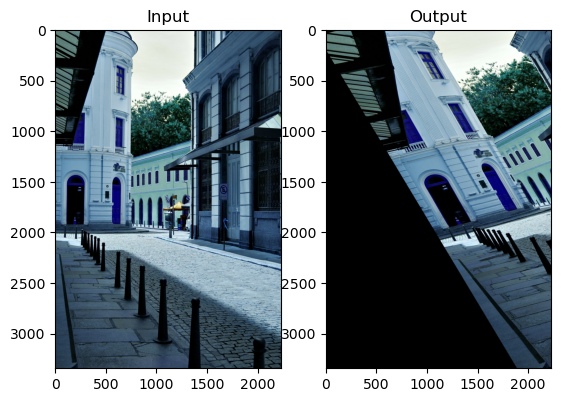

In [14]:
img = cv.imread("image.jpg")
assert img is not None, "file could not read, check with os.path.exists()"
rows, cols, ch = img.shape

pts1 = np.float32([[50,50],[200,50],[50,200]])
pts2 = np.float32([[10,100],[200,50],[100,250]])

M = cv.getAffineTransform(pts1, pts2)

dst = cv.warpAffine(img, M, (cols, rows))

plt.subplot(121),plt.imshow(img),plt.title("Input")
plt.subplot(122),plt.imshow(dst),plt.title("Output")
plt.show()

#### Perspective Transformation

For perspective transformation, you need a 3$\times$3 transformation matrix. Straight lines will remain straght even after the transformation. To find this transformation matrix, you need 4 points on the input image and corresponding points on the output image. Among these 4 points, 3 of them should not be collinear, Then the transformation matrix can be found by the function **cv.getPerspectiveTransform** Then apply **cv.warpPerspective** with this 3$\times$3 transformation matrix

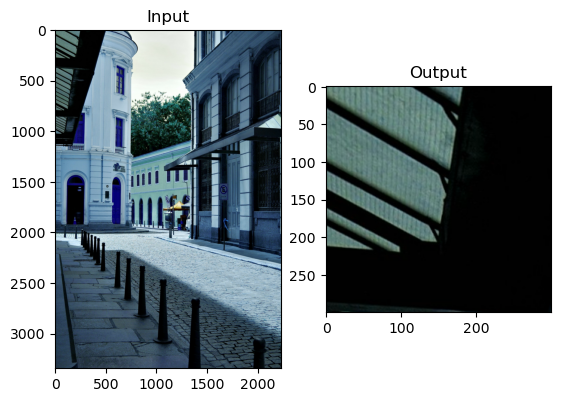

In [15]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"
rows, cols, ch = img.shape

pts1 = np.float32([[56,65],[368,52],[28,387],[389,390]])
pts2 = np.float32([[0,0],[300,0],[0,300],[300,300]])

M = cv.getPerspectiveTransform(pts1,pts2)

dst = cv.warpPerspective(img,M,(300,300))

plt.subplot(121),plt.imshow(img),plt.title("Input")
plt.subplot(122),plt.imshow(dst),plt.title("Output")
plt.show()

### Image Thresholding

#### Simple Thresholding

Here, the matter is straight-forward. For every pixel, the same threshold value is applied. if the pixel value is smaller than the threshold, it is set to 0, otherwise it is set to a maximun value. The function **cv.threshold** is used to apply the thresholding.<br>The first argument is the source image, which **shold be a grayscale image**.<br>The second argument is the threshold value which is used to classify the pixel values.<br>The third argument is the maximum value which is assigned to pixel values exceeding the threshold.<br>OpenCV provides different types of thresholding which is given by the fourth parameter of the function.<br>Basicthresholding as descripbed above is done by using the type **cv.THRESH_BINARY**.<br>All simple thresholding types are:
- cv.THRESH_BINARY
- cv.THRESH_BINARY_INV
- cv.THRESH_TRUNC
- cv.THRESH_TOZERO
- cv.THRESH_TOZERO_INV

The method returns two outputs. The first is the threshold that was used and the second output is the thresholded image.

In [16]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

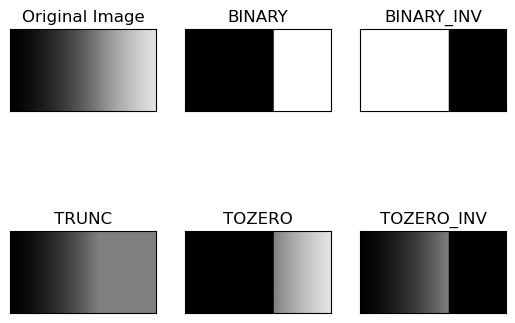

In [17]:
img = cv.imread("gradient.png", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"

ret, thresh1 = cv.threshold(img,127,255,cv.THRESH_BINARY)
ret, thresh2 = cv.threshold(img,127,255,cv.THRESH_BINARY_INV)
ret, thresh3 = cv.threshold(img,127,255,cv.THRESH_TRUNC)
ret, thresh4 = cv.threshold(img,127,255,cv.THRESH_TOZERO)
ret, thresh5 = cv.threshold(img,127,255,cv.THRESH_TOZERO_INV)

title = ["Original Image","BINARY","BINARY_INV","TRUNC","TOZERO","TOZERO_INV"]
images = [img, thresh1, thresh2, thresh3, thresh4, thresh5]

for i in range(6):
    plt.subplot(2,3,i+1),plt.imshow(images[i],'gray',vmin=0,vmax=255)
    plt.title(title[i])
    plt.xticks([]),plt.yticks([])

plt.show()

#### Adaptive Thresholding

Here, the algorithm determines the threshold for a pixel based on a small region around it. So we get different thresholds for different regions of the same image which gives better results for images with varying illumination.

In addition to the parameters described above, the method **cv.adaptiveThreshold takes three input parameters:

The adaptive Method decides how the threshold value is calculated:
- cv.ADAPTIVE_THRESH_MEAN_C: The threshold value is the mean of the neighbourhood area minus the constant **C**.
- cv.ADAPTIVE_THRESH_GAUSSIAN_C: The threshold value is a gaussian-weighted sum of the neighbourhood  values minus the constant **C**.

The **blockSize** determines the size of the neighbourhood area and C is a constant that is subtracted from the mean or weighted sum of the neighbourhood pixels.

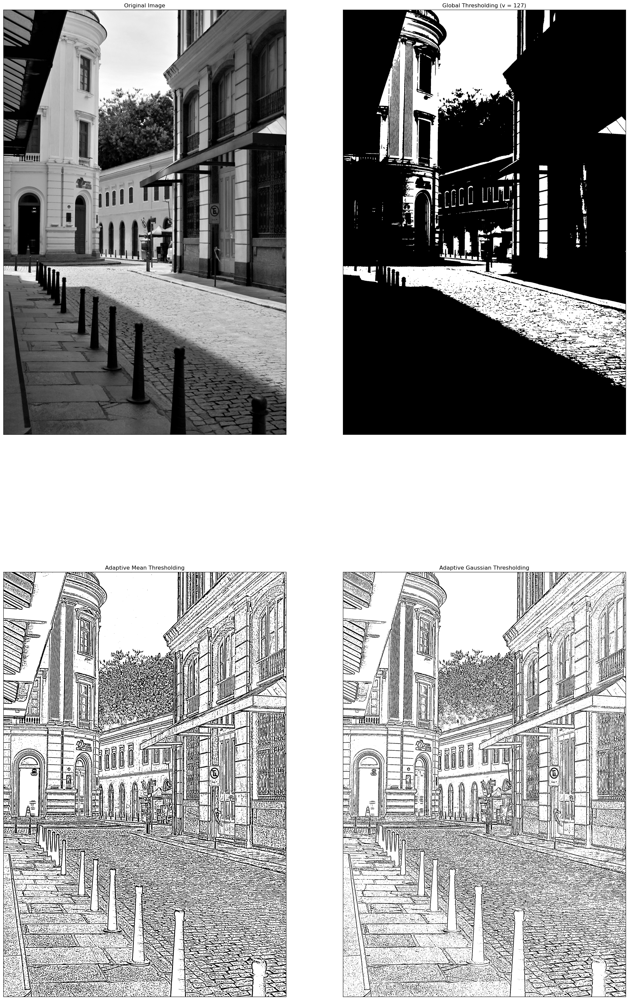

In [18]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
img = cv.medianBlur(img,5)

ret,th1 = cv.threshold(img,177,255,cv.THRESH_BINARY)
th2 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_MEAN_C, cv.THRESH_BINARY,11,2)
th3 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY,11,2)

titles = ["Original Image", "Global Thresholding (v = 127)","Adaptive Mean Thresholding", "Adaptive Gaussian Thresholding"]
images = [img, th1, th2, th3]

plt.figure(figsize=(24,40))

for i in range(4):
    plt.subplot(2,2,i+1),plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])

plt.show()

#### Otsu's Binarization

In global thresholding, we use an arbitrary chosen value as a threshoold. incontrast, Otsu's method avoids having to choose a value and determines it automatically.

Consider an image with only two distinct image values (**bimodal image**), where the histogram would only consist of two peaks. A good threshold would be in the middle of those two values.Similaly, Otsu's method determines an optimal global threshold value from the image histogram.

In order to do so, the **cv.threshold() function** is used, where **cv.THRESH_OTSU** is passed as an extra flag. The threshold value can be chosen arbitrary. The algorithm then finds the optimal threshold value which is returned as the first output.

Check out the example below. The input image is a noisy image. In the third case, the image is first filltered with a 5$\times$5 gaussian kernel to remove the noise, then Otsu thresholding is applied.

In [19]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

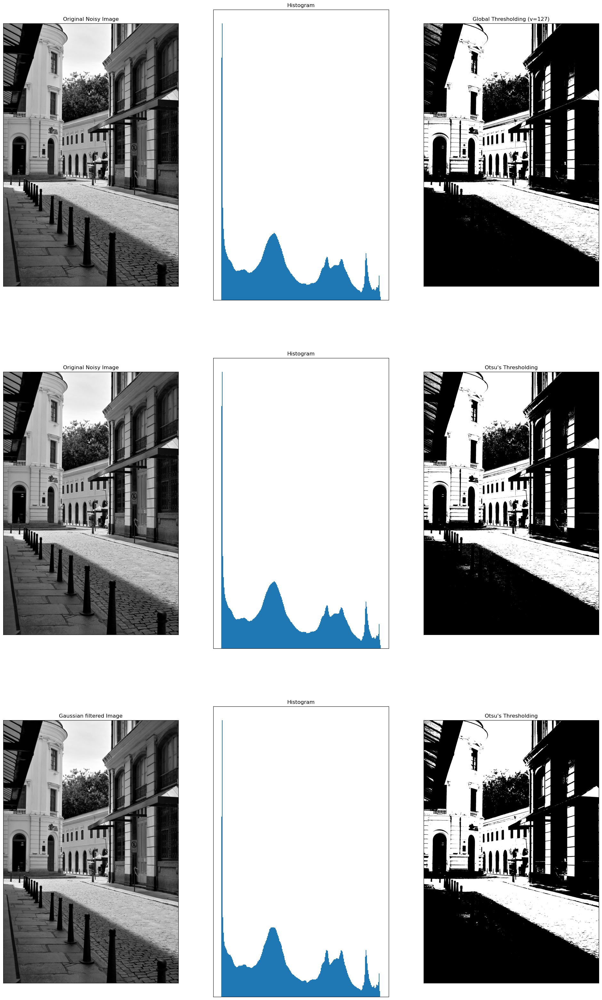

In [20]:
img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"

# global thresholding
ret1, th1 = cv.threshold(img, 127, 255, cv.THRESH_BINARY)

# Otsu's thresholding
ret2, th2 = cv.threshold(img, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)

# Otsu's thresholding after Gaussian filtering
blur = cv.GaussianBlur(img, (5,5),0)
ret3, th3 = cv.threshold(blur, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)

# plot all the images and their histograms
images = [img, 0, th1,
         img, 0, th2,
         blur, 0, th3]
titles = ["Original Noisy Image", "Histogram", "Global Thresholding (v=127)",
          "Original Noisy Image", "Histogram", "Otsu's Thresholding",
          "Gaussian filtered Image", "Histogram", "Otsu's Thresholding"]
plt.figure(figsize=(24,40))

for i in range(3):
    plt.subplot(3,3,i*3+1), plt.imshow(images[i*3], 'gray')
    plt.title(titles[i*3]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+2), plt.hist(images[i*3].ravel(), 256)
    plt.title(titles[i*3+1]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+3), plt.imshow(images[i*3+2], 'gray')
    plt.title(titles[i*3+2]), plt.xticks([]), plt.yticks([])

plt.show()

#### How does Otsu's Binarization work?

This section demonstrates a Python implementation of Otsu's binarization to show how it actually works.

Since we are working with bimodal images, Otsu's algorithm tries to find a threshold value (t) which minimizes the **weighted within-class variance** given by the relation: 
$$\sigma^{2}_{w}(t) = q_{1}(t)\sigma^{2}_{1}(t) + q_{2}(t)\sigma^{2}_{2}(t)$$
where
$$q_{1}(t) = \sum_{i=1}^{t}P(i) \qquad \& \qquad q_{2}(t) = \sum_{i=t+1}^{I} P(t)$$
$$\mu_{1}(t) = \sum_{i=1}^{t}\frac{iP(i)}{q_{1}(t)} \qquad \& \qquad \mu_{2}(t) = \sum_{i=t+1}^{I} \frac{iP(i)}{q_{2}(t)} $$
$$\sigma_{1}^{2}(t) = \sum_{i=1}^{t} \left[i - \mu_{1}(t) \right]^2 \frac{P(i)}{q_{1}(t)} \& \sigma_{2}^{2}(t) = \sum_{i=1+1}^{t} \left[i - \mu_{2}(t) \right]^2 \frac{P(i)}{q_{2}(t)}$$

In [21]:
img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
blur = cv.GaussianBlur(img,(5,5),0)

# find normalized_histogram, and its cumulative distribution function
hist = cv.calcHist([blur],[0],None,[256],[0,256])
hist_norm = hist.ravel()/hist.sum()
Q = hist_norm.cumsum()

bins = np.arange(256)

fn_min = np.inf
thresh = -1

for i in range(1,256):
    p1,p2 = np.hsplit(hist_norm,[i]) #probabilities
    q1,q2 = Q[i],Q[255]-Q[i] # cum sum of classes
    if q1 < 1.e-6 or q2 < 1.e-6:
        continue
    b1,b2 = np.hsplit(bins,[i]) #weights

    # finding means and variances
    m1, m2 = np.sum(p1*b1)/q1, np.sum(p2*b2)/q2
    v1, v2 = np.sum(((b1-m1)**2)*p1)/q1, np.sum(((b2-m2)**2)*p2)/q2

    # calculates the minimization function
    fn = v1*q1 + v2*q2
    if fn < fn_min:
        fn_min = fn
        thresh = i

# find otsu's threshold value with OpenCV function
ret, otsu = cv.threshold(blur, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)
print("{} {}".format(thresh, ret))

120 119.0


### Smotting Images

#### 2D Convolution (Image Filtering)

In [22]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

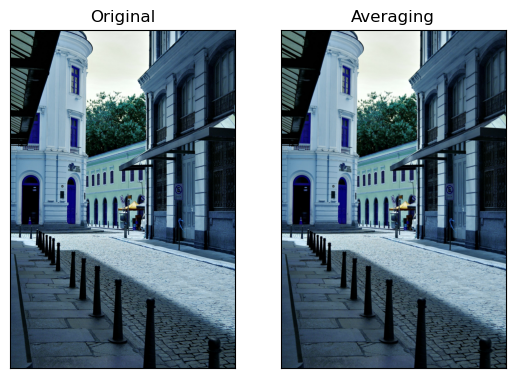

In [23]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"

kernel = np.ones((5,5), np.float32)/25
dst = cv.filter2D(img, -1, kernel)

plt.subplot(121),plt.imshow(img),plt.title("Original"),
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(dst),plt.title("Averaging"),
plt.xticks([]), plt.yticks([])

plt.show()

#### Image Blurring (Image Smoothing)

#### Averaging

In [24]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

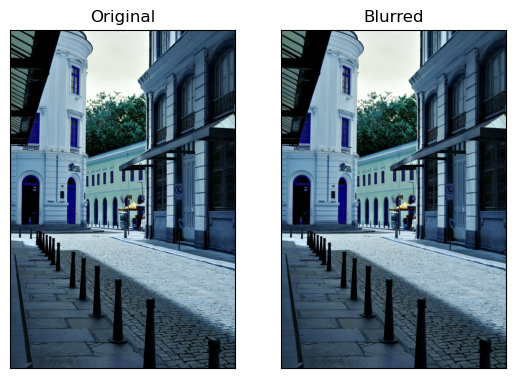

In [25]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"

blur = cv.blur(img,(5,5))

plt.subplot(121),plt.imshow(img),plt.title("Original"),
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(blur),plt.title("Blurred"),
plt.xticks([]), plt.yticks([])

plt.show()

#### Gaussian Blurring

In [26]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

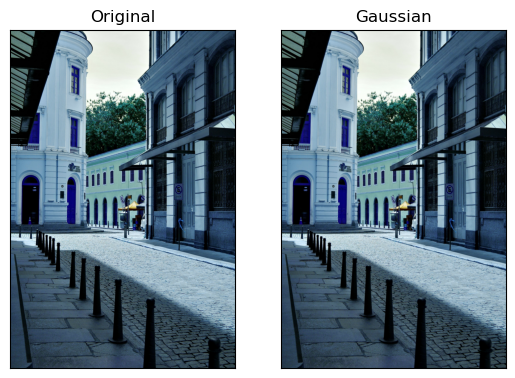

In [27]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"

blur = cv.GaussianBlur(img,(5,5),0)

plt.subplot(121),plt.imshow(img),plt.title("Original"),
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(blur),plt.title("Gaussian"),
plt.xticks([]), plt.yticks([])

plt.show()

#### Median Blurring

In [28]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

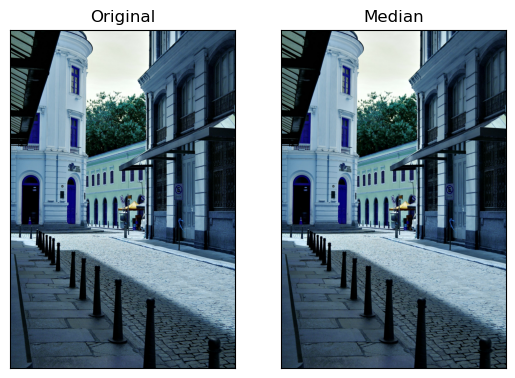

In [29]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"

median = cv.medianBlur(img,5)

plt.subplot(121),plt.imshow(img),plt.title("Original"),
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(median),plt.title("Median"),
plt.xticks([]), plt.yticks([])

plt.show()

#### Bilateral Filtering

In [30]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

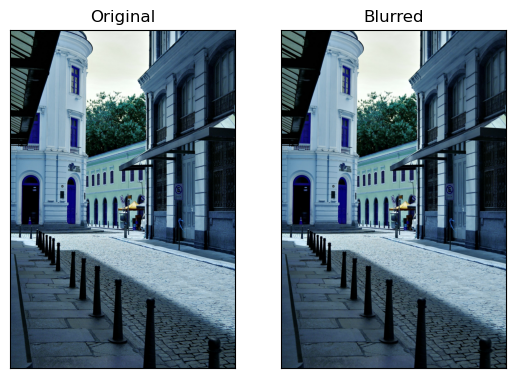

In [31]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"

blur = cv.bilateralFilter(img,9,75,75)

plt.subplot(121),plt.imshow(img),plt.title("Original"),
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(blur),plt.title("Blurred"),
plt.xticks([]), plt.yticks([])

plt.show()

### Morphological Transformations

#### Erosion

In [32]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

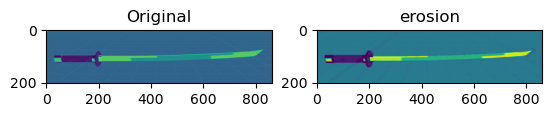

In [33]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
kernel = np.ones((5,5),np.uint8)
erosion = cv.erode(img,kernel,iterations = 1)
plt.subplot(121),plt.imshow(img),plt.title("Original")
plt.subplot(122),plt.imshow(erosion),plt.title("erosion")
plt.show()

#### Dilation

In [34]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

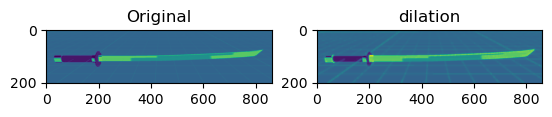

In [35]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
kernel = np.ones((5,5),np.uint8)
dilation = cv.dilate(img,kernel,iterations = 1)
plt.subplot(121),plt.imshow(img),plt.title("Original")
plt.subplot(122),plt.imshow(dilation),plt.title("dilation")
plt.show()

#### Opening

In [36]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

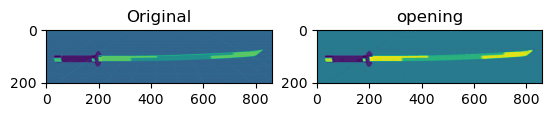

In [37]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
kernel = np.ones((5,5),np.uint8)
opening = cv.morphologyEx(img,cv.MORPH_OPEN,kernel)
plt.subplot(121),plt.imshow(img),plt.title("Original")
plt.subplot(122),plt.imshow(opening),plt.title("opening")
plt.show()

#### Closing

In [38]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

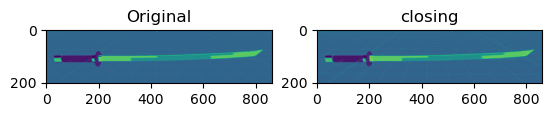

In [39]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
kernel = np.ones((5,5),np.uint8)
closing = cv.morphologyEx(img,cv.MORPH_CLOSE,kernel)
plt.subplot(121),plt.imshow(img),plt.title("Original")
plt.subplot(122),plt.imshow(closing),plt.title("closing")
plt.show()

#### Morphological Gradient

In [40]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

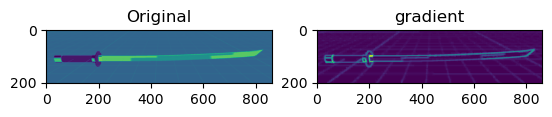

In [41]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
kernel = np.ones((5,5),np.uint8)
gradient = cv.morphologyEx(img,cv.MORPH_GRADIENT,kernel)
plt.subplot(121),plt.imshow(img),plt.title("Original")
plt.subplot(122),plt.imshow(gradient),plt.title("gradient")
plt.show()

#### Top Hat

It is the difference between input image and Opening of the image

In [42]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

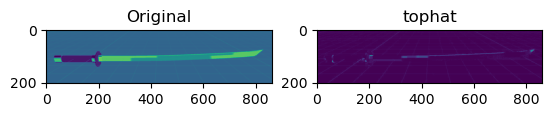

In [43]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
kernel = np.ones((9,9),np.uint8)
tophat = cv.morphologyEx(img,cv.MORPH_TOPHAT,kernel)
plt.subplot(121),plt.imshow(img),plt.title("Original")
plt.subplot(122),plt.imshow(tophat),plt.title("tophat")
plt.show()

#### Black Hat

It is the difference between input image and closing of the input image.

In [44]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

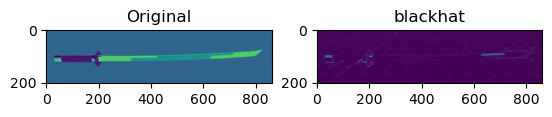

In [45]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
kernel = np.ones((9,9),np.uint8)
blackhat = cv.morphologyEx(img,cv.MORPH_BLACKHAT,kernel)
plt.subplot(121),plt.imshow(img),plt.title("Original")
plt.subplot(122),plt.imshow(blackhat),plt.title("blackhat")
plt.show()

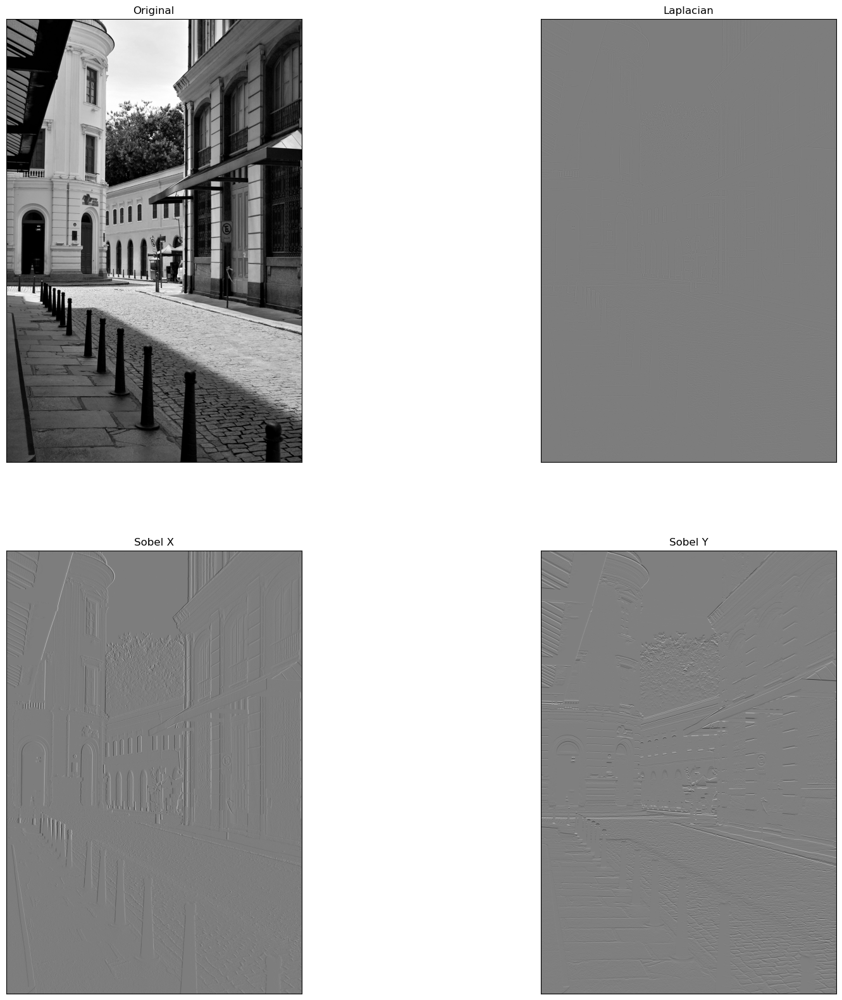

In [46]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
 
img = cv.imread('image.jpg', cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
 
laplacian = cv.Laplacian(img,cv.CV_64F)
sobelx = cv.Sobel(img,cv.CV_64F,1,0,ksize=5)
sobely = cv.Sobel(img,cv.CV_64F,0,1,ksize=5)

plt.figure(figsize=(20,20))
 
plt.subplot(2,2,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,3),plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,4),plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])
 
plt.show()

### Canny Edge Detection

#### Canny Edge Detection in OpenCV

In [47]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

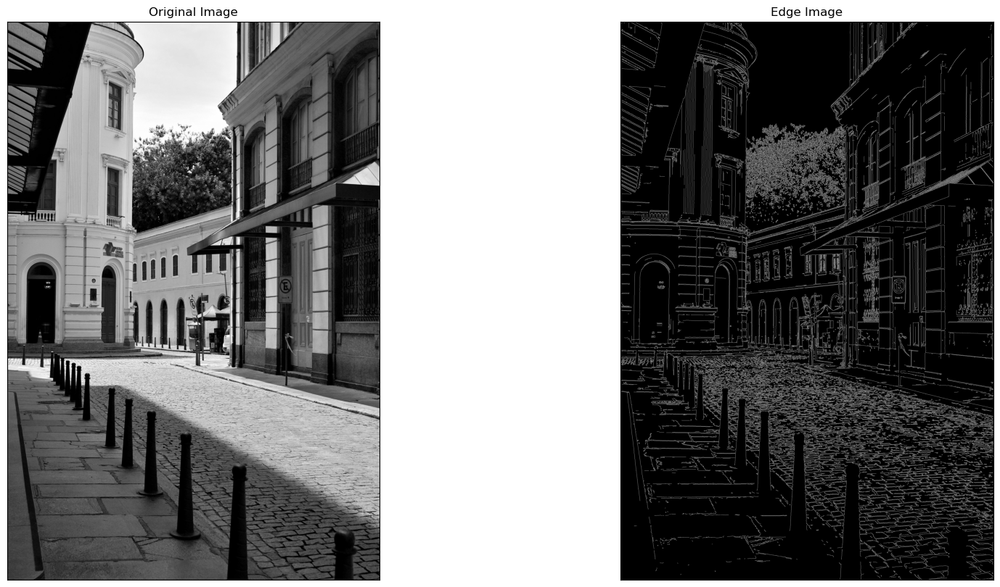

In [49]:
img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
edges = cv.Canny(img, 100, 200)

plt.figure(figsize=(20,10))

plt.subplot(121),plt.imshow(img, cmap = "gray")
plt.title("Original Image"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(edges, cmap = "gray")
plt.title("Edge Image"), plt.xticks([]), plt.yticks([])

plt.show()

### Image Pyramids

In [51]:
import cv2 as cv
import numpy as np

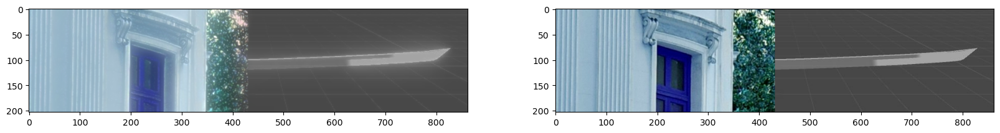

In [98]:
A = cv.imread("image.jpg")
B = cv.imread("saber.jpg")
assert A is not None, "file could not be read, check with os.path.exists()"
assert B is not None, "file could not be read, check with os.path.exists()"
A = A[800:1003,400:1262,:]


# generate Gaussian pyramid for A
G = A.copy()
gpA = [G]
for i in range(6):
    G = cv.pyrDown(G)
    gpA.append(G)

# generate Gaussian pyramid for B
G = B.copy()
gpB = [G]
for i in range(6):
    G = cv.pyrDown(G)
    gpB.append(G)

# generate Laplacian Pyramid for A
lpA = [gpA[5]]
for i in range(5,0,-1):
    AShape=gpA[i-1].shape
    GE = cv.pyrUp(gpA[i])[:AShape[0],:AShape[1],:AShape[2]]
    L = cv.subtract(gpA[i-1], GE)
    lpA.append(L)

# generate Laplacian Pyramid for B
lpB = [gpB[5]]
for i in range(5,0,-1):
    BShape=gpA[i-1].shape
    GE = cv.pyrUp(gpB[i])[:BShape[0],:BShape[1],:BShape[2]]
    L = cv.subtract(gpB[i-1],GE)
    lpB.append(L)

# Now add left and right halves of images in each level
LS = []
for la, lb in zip(lpA, lpB):
    rows, cols, dpt = la.shape
    ls = np.hstack((la[:,0:cols//2], lb[:,cols//2:]))
    LS.append(ls)

#now reconstruct
ls_ = LS[0]
for i in range(1,6):
    LSShape = LS[i].shape
    ls_ = cv.pyrUp(ls_)[:LSShape[0],:LSShape[1],:LSShape[2]]
    ls_ = cv.add(ls_, LS[i])

#image with direct connecting each half
real = np.hstack((A[:,:cols//2],B[:,cols//2:]))

plt.figure(figsize=(20,10))

plt.subplot(121),plt.imshow(ls_)
plt.subplot(122),plt.imshow(real)

plt.show()

In [66]:
A.shape

(203, 862, 3)

In [67]:
B.shape

(203, 862, 3)

In [92]:
ls_.shape

(14, 54, 3)

In [93]:
LS[i].shape

(13, 54, 3)

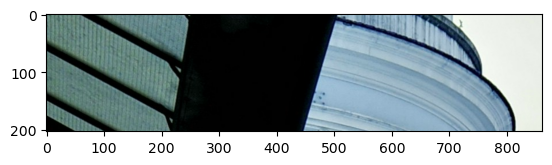

In [96]:
plt.imshow(A)

### Countours in OpenCV

#### Contours : Getting Started

In [241]:
import numpy as np
import cv2 as cv

im = cv.imread("saber.jpg")
assert im is not None, "file could not be read, check with os.path.exists()"

imgray = cv.cvtColor(im, cv.COLOR_BGR2GRAY)
ret, thresh = cv.threshold(imgray, 100, 255, 0)
ret2, thresh2 = cv.threshold(imgray, 50, 255, 0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
contours2, hierarchy2 = cv.findContours(thresh2, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

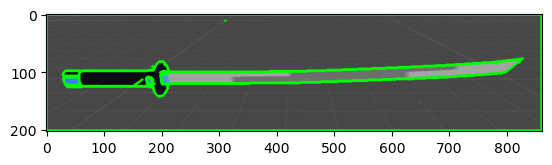

In [195]:
contoured = cv.drawContours(im, contours, -1, (0,255,0), 3)
contoured = cv.drawContours(im, contours2, -1, (0,255,0), 3)
plt.imshow(contoured)

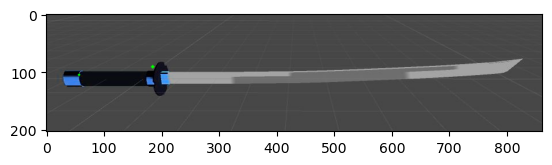

In [197]:
contoured = cv.drawContours(im, contours, 3, (0,255,0), 3)
contoured = cv.drawContours(im, contours2, 3, (0,255,0), 3)
plt.imshow(contoured)

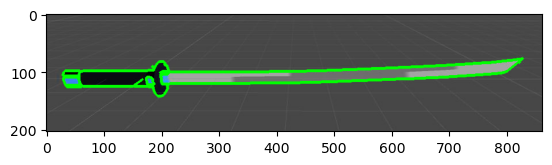

In [250]:
cnt = contours[5]
contoured = cv.drawContours(im, [cnt], 0, (0,255,0), 3)
cnt = contours2[5]
contoured = cv.drawContours(im, [cnt], 0, (0,255,0), 3)
plt.imshow(contoured)

#### Contour Features

In [252]:
import numpy as np
import cv2 as cv

In [391]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
ret, thresh = cv.threshold(img, 100,255,0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

cnt = contours[5]
M = cv.moments(cnt)
print(M)

{'m00': 12189.5, 'm10': 6188205.666666666, 'm01': 1272017.0, 'm20': 3524892920.083333, 'm11': 633309422.5416666, 'm02': 133607087.75, 'm30': 2178201801828.4001, 'm21': 354477058762.45, 'm12': 65280388815.049995, 'm03': 14120591933.6, 'mu20': 383345738.2493415, 'mu11': -12451503.459919453, 'mu02': 867660.5143463612, 'mu30': -493541041.04296875, 'mu21': -715425669.8281174, 'mu12': 51208834.88445306, 'mu03': -2862251.3498649597, 'nu20': 2.5799949510303155, 'nu11': -0.08380115612093642, 'nu02': 0.005839532106043502, 'nu30': -0.030085590751257885, 'nu21': -0.04361137600615338, 'nu12': 0.003121620941445194, 'nu03': -0.00017447895023541818}


In [378]:
cx = int(M["m10"]/M["m00"])
cy = int(M["m01"]/M["m00"])

In [379]:
area = cv.contourArea(cnt)

In [380]:
perimeter = cv.arcLength(cnt,True)

In [381]:
perimeter

1335.036577820778

In [382]:
epsilon = 0.1*perimeter
approx = cv.approxPolyDP(cnt, epsilon,True)

In [383]:
approx

array([[[828,  77]],

       [[199, 108]]], dtype=int32)

In [384]:
hull = cv.convexHull(cnt)

In [385]:
k = cv.isContourConvex(cnt)

In [386]:
k

False

In [387]:
x,y,w,h = cv.boundingRect(cnt)
cv.rectangle(img,(x,y),(x+w,y+h),(0,255,0),2)

array([[69, 69, 70, ..., 72, 72, 72],
       [71, 71, 71, ..., 70, 69, 69],
       [73, 73, 73, ..., 76, 76, 75],
       ...,
       [71, 71, 71, ..., 71, 71, 71],
       [71, 71, 71, ..., 71, 71, 71],
       [71, 71, 71, ..., 71, 71, 71]], dtype=uint8)

In [391]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
ret, thresh = cv.threshold(img, 100,255,0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

cnt = contours[5]
M = cv.moments(cnt)
print(M)

{'m00': 12189.5, 'm10': 6188205.666666666, 'm01': 1272017.0, 'm20': 3524892920.083333, 'm11': 633309422.5416666, 'm02': 133607087.75, 'm30': 2178201801828.4001, 'm21': 354477058762.45, 'm12': 65280388815.049995, 'm03': 14120591933.6, 'mu20': 383345738.2493415, 'mu11': -12451503.459919453, 'mu02': 867660.5143463612, 'mu30': -493541041.04296875, 'mu21': -715425669.8281174, 'mu12': 51208834.88445306, 'mu03': -2862251.3498649597, 'nu20': 2.5799949510303155, 'nu11': -0.08380115612093642, 'nu02': 0.005839532106043502, 'nu30': -0.030085590751257885, 'nu21': -0.04361137600615338, 'nu12': 0.003121620941445194, 'nu03': -0.00017447895023541818}


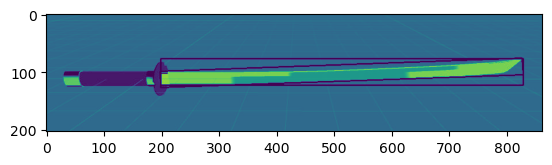

In [388]:
rect = cv.minAreaRect(cnt)
box = cv.boxPoints(rect)
box = np.intp(box)
plt.imshow(cv.drawContours(img,[box],0,(0,0,255),2))

#### Minimunm Enclosing Circle

In [393]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
ret, thresh = cv.threshold(img, 50,255,0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

cnt = contours[5]
M = cv.moments(cnt)
print(M)

{'m00': 4558.5, 'm10': 640533.5, 'm01': 509005.8333333333, 'm20': 99466496.41666666, 'm11': 71574298.20833333, 'm02': 57356975.75, 'm30': 16567910364.85, 'm21': 11120657494.416666, 'm12': 8085576962.783333, 'm03': 6521191205.75, 'mu20': 9462511.636091918, 'mu11': 51804.41752129793, 'mu02': 520968.6495588273, 'mu30': -67766826.46694756, 'mu21': -411240.2664923668, 'mu12': 14544402.076043814, 'mu03': 320875.087061882, 'nu20': 0.4553680000459057, 'nu11': 0.002493003433701391, 'nu02': 0.025070769913916654, 'nu30': -0.04830168153506326, 'nu21': -0.0002931168157357505, 'nu12': 0.010366710584235878, 'nu03': 0.00022870786601403086}


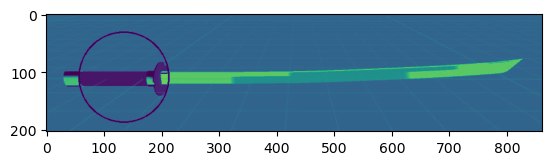

In [394]:
(x,y), radius = cv.minEnclosingCircle(cnt)
center = (int(x),int(y))
radius = int(radius)
plt.imshow(cv.circle(img,center,radius,(0,255,0),2))

#### Fitting an Ellipse

In [401]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
ret, thresh = cv.threshold(img, 50,255,0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

cnt = contours[5]
M = cv.moments(cnt)
print(M)

{'m00': 4558.5, 'm10': 640533.5, 'm01': 509005.8333333333, 'm20': 99466496.41666666, 'm11': 71574298.20833333, 'm02': 57356975.75, 'm30': 16567910364.85, 'm21': 11120657494.416666, 'm12': 8085576962.783333, 'm03': 6521191205.75, 'mu20': 9462511.636091918, 'mu11': 51804.41752129793, 'mu02': 520968.6495588273, 'mu30': -67766826.46694756, 'mu21': -411240.2664923668, 'mu12': 14544402.076043814, 'mu03': 320875.087061882, 'nu20': 0.4553680000459057, 'nu11': 0.002493003433701391, 'nu02': 0.025070769913916654, 'nu30': -0.04830168153506326, 'nu21': -0.0002931168157357505, 'nu12': 0.010366710584235878, 'nu03': 0.00022870786601403086}


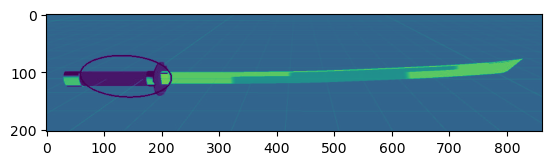

In [402]:
ellipse = cv.fitEllipse(cnt)
plt.imshow(cv.ellipse(img,ellipse,(0,255,0),2))

#### Fitting an Line

In [410]:
img = cv.imread("saber.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
ret, thresh = cv.threshold(img, 100,255,0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

cnt = contours[5]
M = cv.moments(cnt)
print(M)

{'m00': 12189.5, 'm10': 6188205.666666666, 'm01': 1272017.0, 'm20': 3524892920.083333, 'm11': 633309422.5416666, 'm02': 133607087.75, 'm30': 2178201801828.4001, 'm21': 354477058762.45, 'm12': 65280388815.049995, 'm03': 14120591933.6, 'mu20': 383345738.2493415, 'mu11': -12451503.459919453, 'mu02': 867660.5143463612, 'mu30': -493541041.04296875, 'mu21': -715425669.8281174, 'mu12': 51208834.88445306, 'mu03': -2862251.3498649597, 'nu20': 2.5799949510303155, 'nu11': -0.08380115612093642, 'nu02': 0.005839532106043502, 'nu30': -0.030085590751257885, 'nu21': -0.04361137600615338, 'nu12': 0.003121620941445194, 'nu03': -0.00017447895023541818}


C:\Users\user\AppData\Local\Temp\ipykernel_11192\3047240477.py:3: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  lefty = int((-x*vy/vx)+y)
C:\Users\user\AppData\Local\Temp\ipykernel_11192\3047240477.py:4: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  righty = int(((cols-x)*vy/vx)*y)


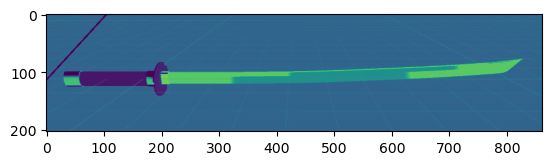

In [411]:
rows,cols = img.shape[:2]
[vx,vy,x,y] = cv.fitLine(cnt, cv.DIST_L2, 0, 0.01, 0.01)
lefty = int((-x*vy/vx)+y)
righty = int(((cols-x)*vy/vx)*y)
plt.imshow(cv.line(img, (cols-1,righty),(0,lefty),(0,255,0),2))

#### Contour Properties

In [412]:
x,y,w,h = cv.boundingRect(cnt)
aspect_ratio = float(w)/h

In [413]:
aspect_ratio

13.695652173913043

In [414]:
area = cv.contourArea(cnt)
x,y,w,h = cv.boundingRect(cnt)
rect_area = w*h
extent = float(area)/rect_area

In [415]:
extent

0.4206176673567978

#### Histograms in OpenCV

##### Histograms -1 : Find, Plot, Analyze

In [418]:
img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
hist = cv.calcHist([img],[0],None,[256],[0,256])

In [425]:
hist, bins = np.histogram(img.ravel(),256,[0,256])

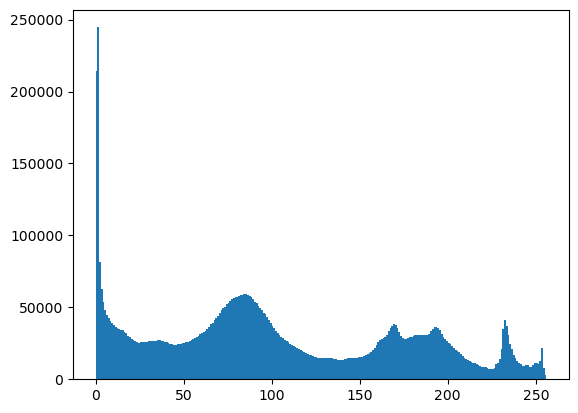

In [430]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"

plt.hist(img.ravel(),256,[0,256]); plt.show()

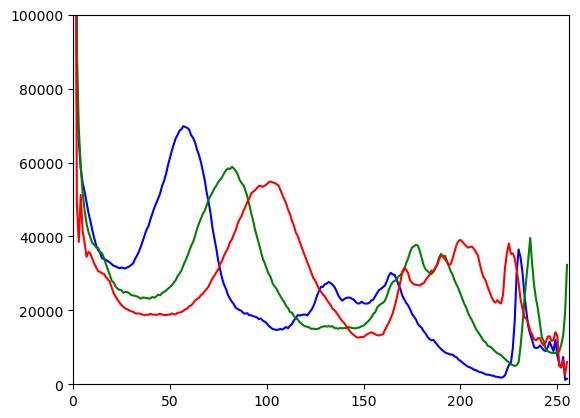

In [434]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"
color = ('b','g','r')
for i, col in enumerate(color):
    histr = cv.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
    plt.ylim([0,100000])

plt.show()

#### Application of Mask

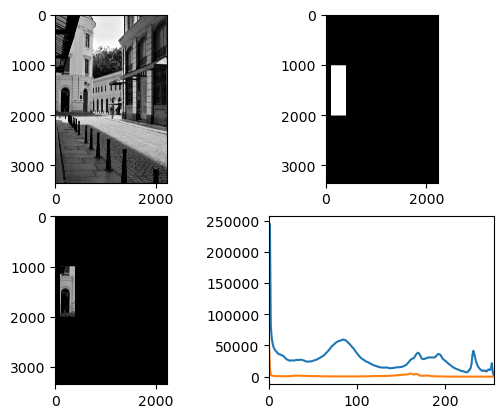

In [438]:
img = cv.imread("image.jpg",cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"

# create a mask
mask = np.zeros(img.shape[:2], np.uint8)
mask[1000:2000, 100:400] = 255
masked_img = cv.bitwise_and(img, img, mask = mask)

# Calculate histogram with mask and without mask
# Check third argument for mask
hist_full = cv.calcHist([img],[0],None, [256],[0,256])
hist_mask = cv.calcHist([img],[0],mask, [256],[0,256])

plt.subplot(221), plt.imshow(img, "gray")
plt.subplot(222), plt.imshow(mask, "gray")
plt.subplot(223), plt.imshow(masked_img, 'gray')
plt.subplot(224), plt.plot(hist_full), plt.plot(hist_mask)
plt.xlim([0,256])

plt.show()

#### Histogram Equalization

In [439]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

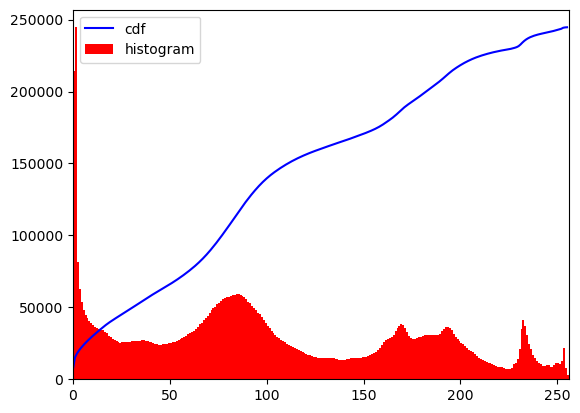

In [440]:
img = cv.imread("image.jpg",cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"

hist, bins = np.histogram(img.flatten(),256,[0,256])

cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()

plt.plot(cdf_normalized, color = 'b')
plt.hist(img.flatten(), 256, [0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'),loc = 'upper left')
plt.show()

In [441]:
cdf_m = np.ma.masked_equal(cdf,0)
cdf_m = (cdf_m - cdf_m.min())*255/(cdf_m.max() - cdf_m.min())
cdf = np.ma.filled(cdf_m, 0).astype('uint8')

In [442]:
img2 = cdf[img]

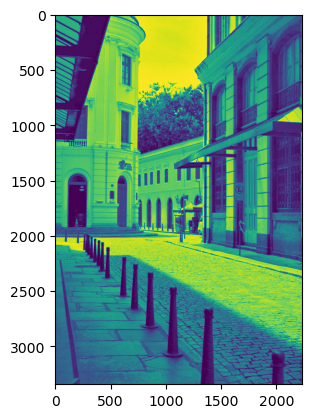

In [443]:
plt.imshow(img2)

#### Histograms Equalization in OpenCV

In [446]:
img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
equ = cv.equalizeHist(img)
res = np.hstack((img,equ)) #stacking images side-by-side
cv.imwrite('res.jpg',res)

True

#### CLAHE ( Contrast Limited Adaptive Histogram Equalization)

In [447]:
import numpy as np
import cv2 as cv

In [448]:
img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"

# create a CLAHE object (Arguments are optional).
clahe = cv.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
cli = clahe.apply(img)

cv.imwrite("res.jpg",cli)

True

#### 2D Histograms

##### OpenCV

In [449]:
import numpy as np
import cv2 as cv

In [450]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"
hsv = cv.cvtColor(img,cv.COLOR_BGR2HSV)

hist = cv.calcHist([hsv],[0,1], None, [180, 256], [0, 180, 0, 256])

##### Numpy

In [457]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

In [479]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"
hsv = cv.cvtColor(img, cv.COLOR_BGR2HSV)
h, s, v = cv.split(hsv)

hist, xbins, ybins = np.histogram2d(h.ravel(), s.ravel(), [180,256], [[0,180],[0,256]])

#### Plotting 2D Histograms

using cv.imshow(), matplotlib

In [476]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

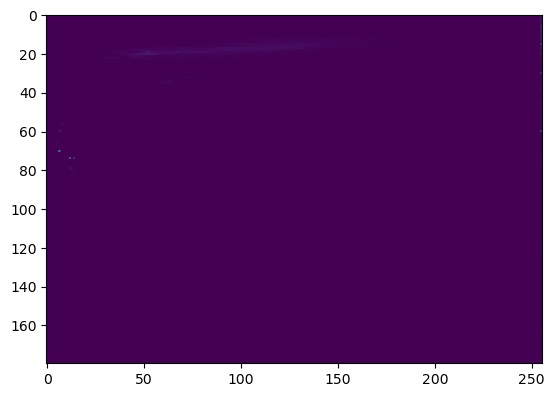

In [477]:
img = cv.imread("image.jpg")
assert img is not None, "file could not be read, check with os.path.exists()"

hsv = cv.cvtColor(img,cv.COLOR_BGR2HSV)
hist = cv.calcHist([hsv], [0,1], None, [180, 256], [0, 180, 0, 256])

plt.imshow(hist, interpolation = "nearest")
plt.show()

#### Histogram Backprojection

##### Algorithm in Numpy

In [482]:
import numpy as np
import cv2 as cv

In [495]:
roi = cv.imread("image.jpg")
assert roi is not None, "file could not be read, check with os.path.exists()"
hsv = cv.cvtColor(roi, cv.COLOR_BGR2HSV)

target = cv.imread("saber.jpg")
assert target is not None, "file could not be read, check with os.path.exists()"
hsvt = cv.cvtColor(target, cv.COLOR_BGR2HSV)

# calculating object histogram
roihist = cv.calcHist([hsv],[0, 1], None, [180, 256], [0, 180, 0, 256])

# normalize histogram and apply backprojection
cv.normalize(roihist, roihist, 0,255,cv.NORM_MINMAX)
dst = cv.calcBackProject([hsvt],[0,1], roihist, [0,180,0,256],1)

# None convolute with circular disc
disc = cv.getStructuringElement(cv.MORPH_ELLIPSE,(5,5))
cv.filter2D(dst,-1,disc,dst)

# threshold and binary AND
ret, thresh = cv.threshold(dst, 50, 255, 0)
thresh = cv.merge((thresh, thresh, thresh))
res = cv.bitwise_and(target,thresh)

res = np.vstack((target,thresh, res))
cv.imwrite("res.jpg",res)

True

#### Template Matching

Template Matching in OpenCV

In [503]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

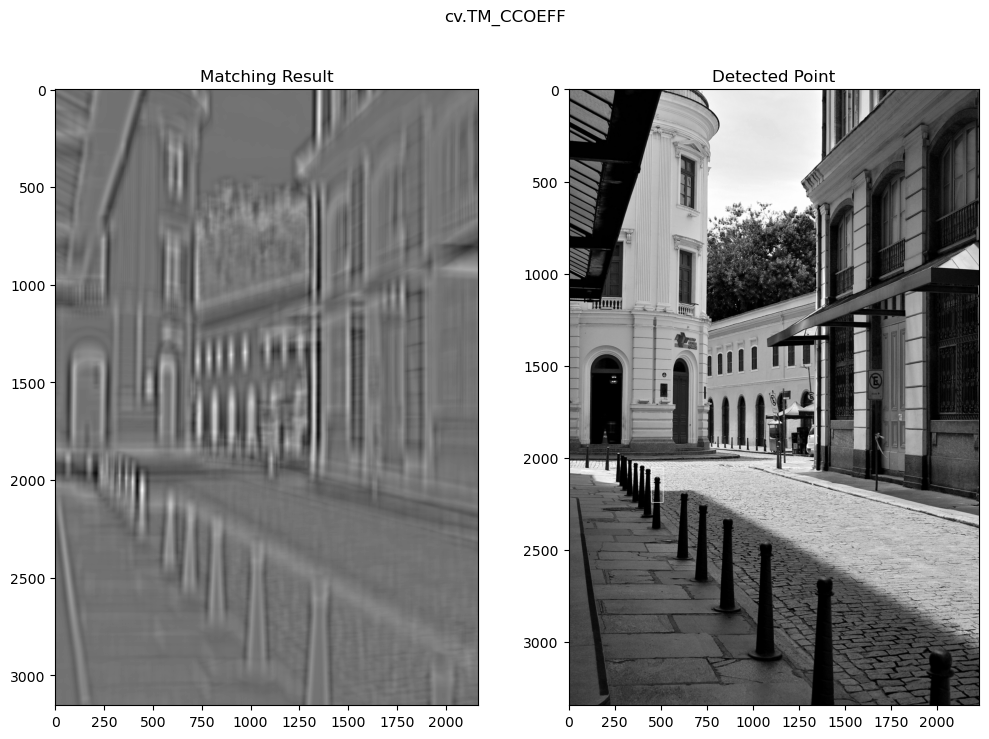

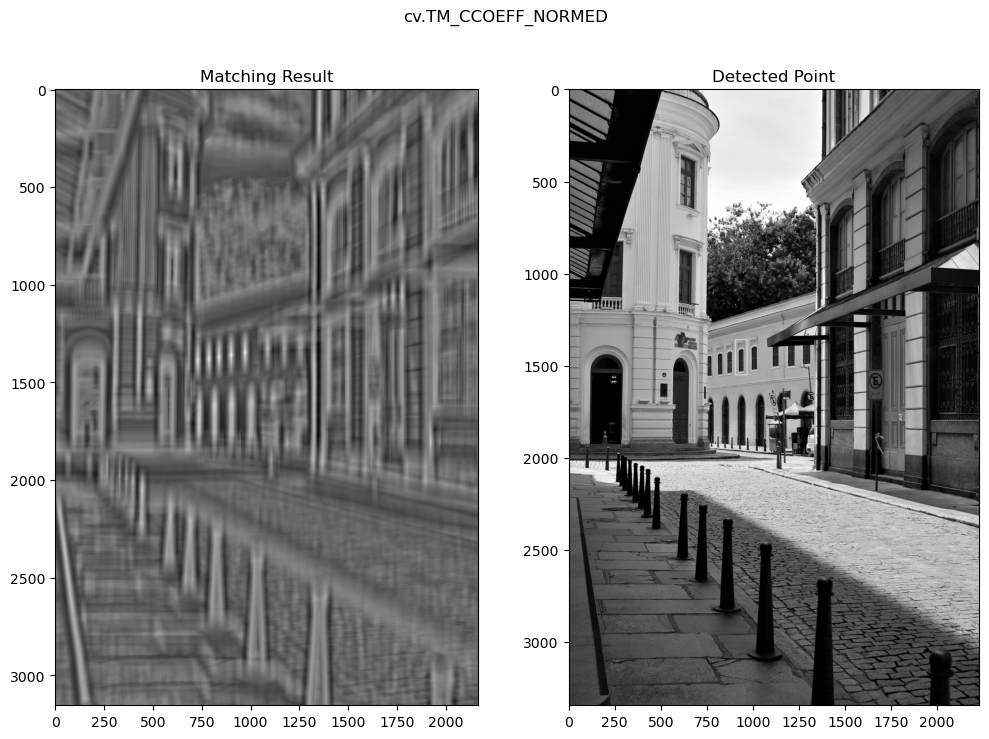

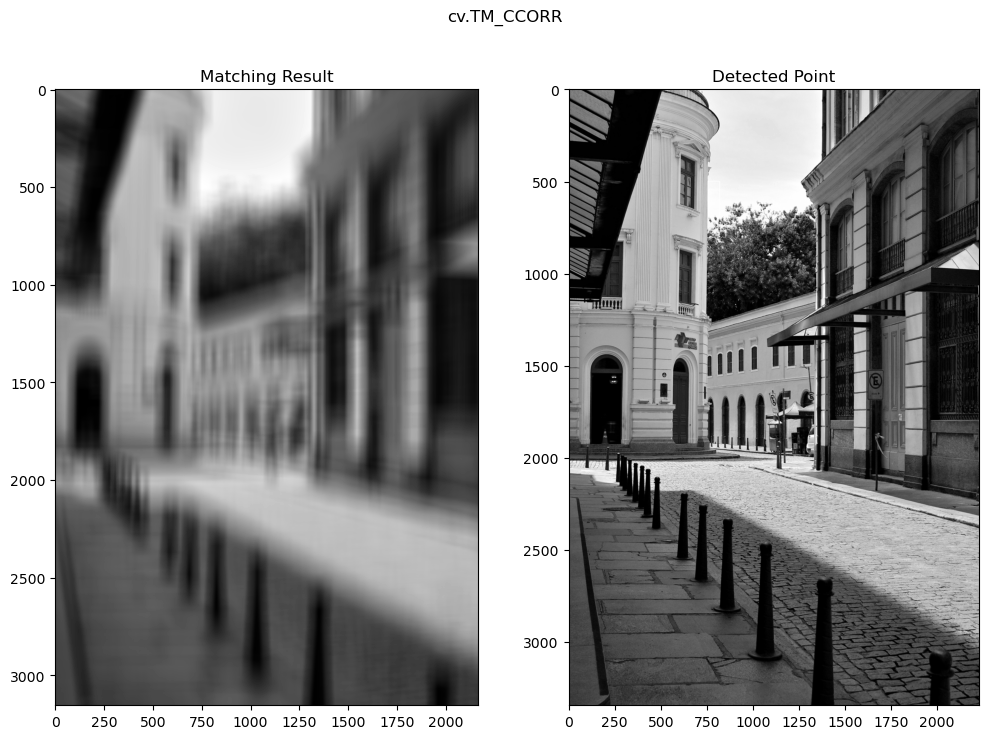

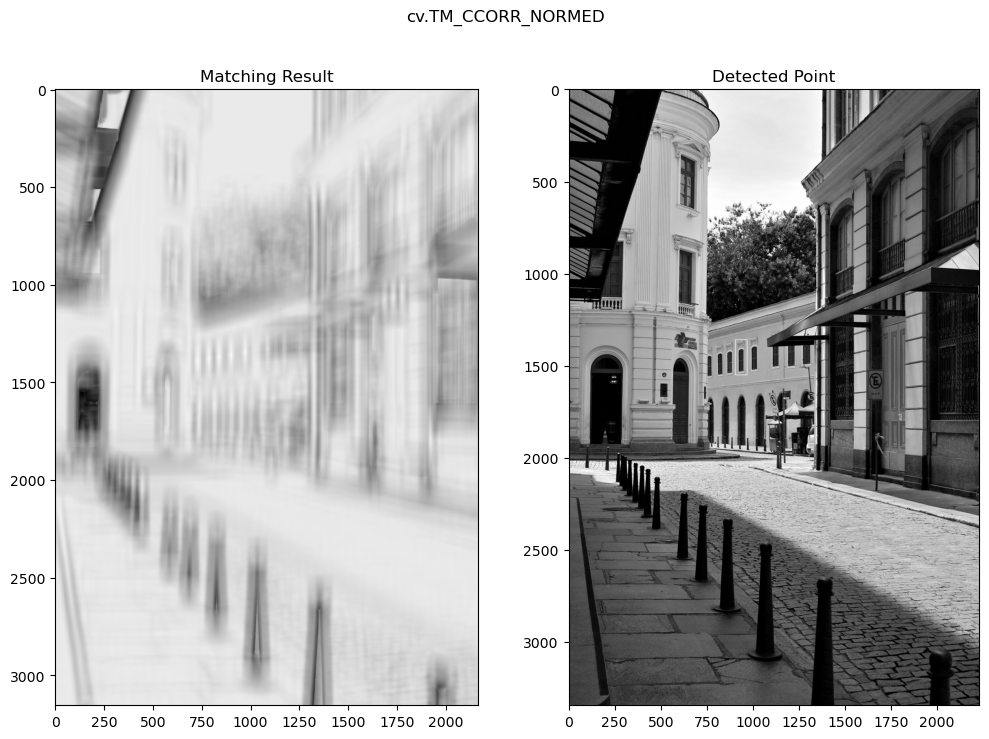

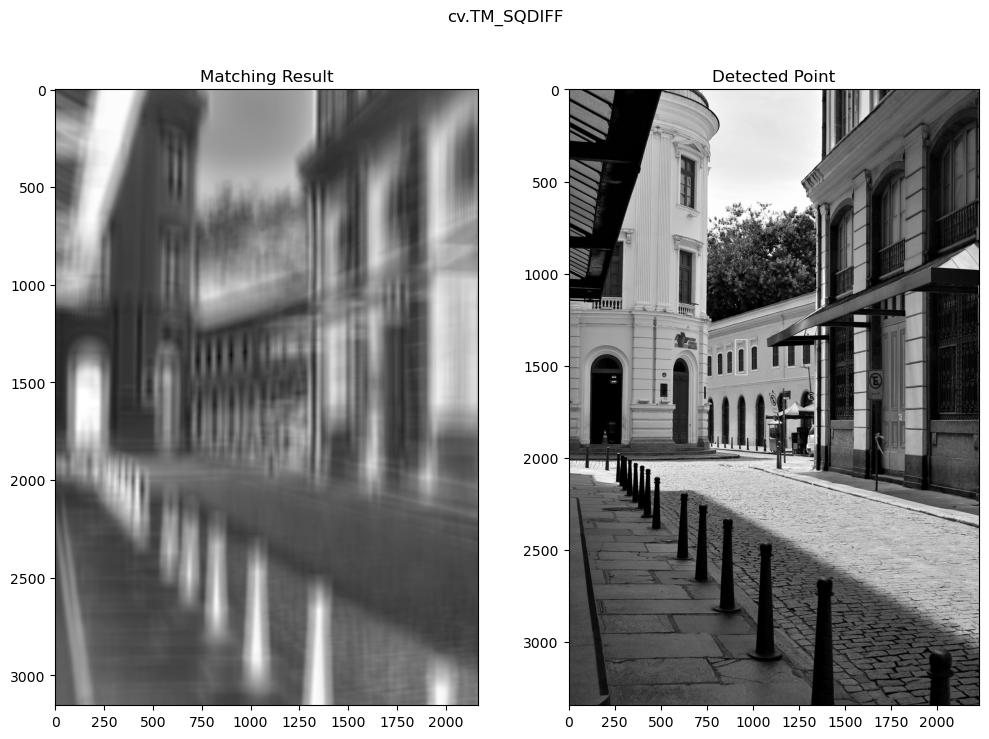

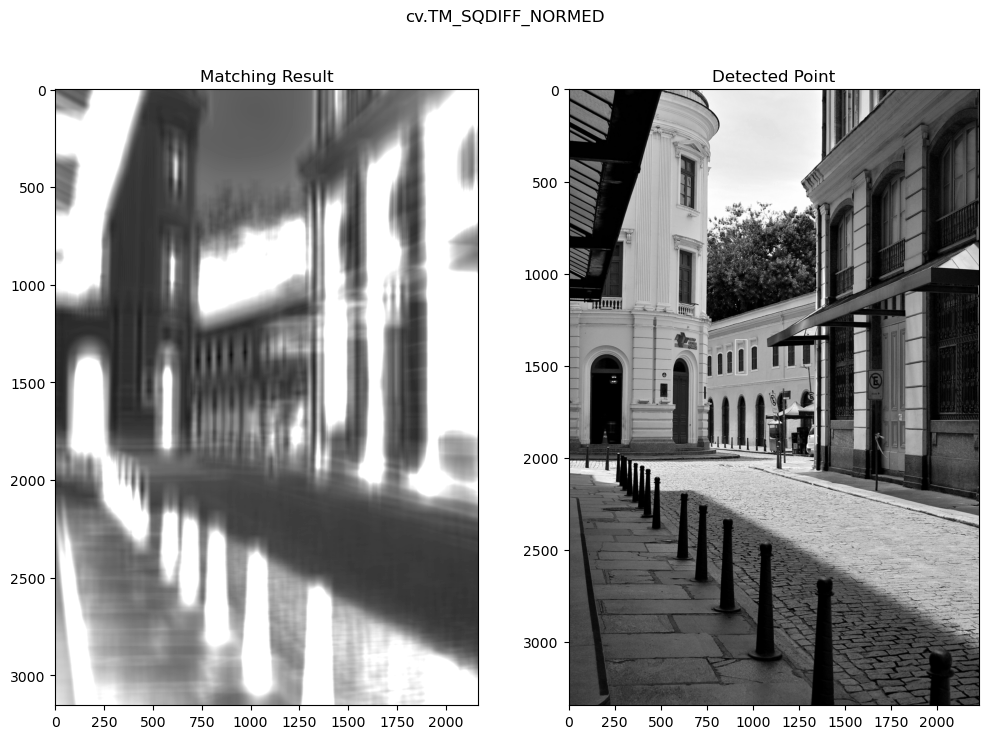

In [510]:
img = cv.imread("image.jpg", cv.IMREAD_GRAYSCALE)
img2 = img.copy()
template = cv.imread("template.jpg", cv.IMREAD_GRAYSCALE)
w, h = template.shape[::-1]

# All the 6 methods for comparision in a list
methods = ["cv.TM_CCOEFF", "cv.TM_CCOEFF_NORMED", "cv.TM_CCORR",
          "cv.TM_CCORR_NORMED", "cv.TM_SQDIFF", "cv.TM_SQDIFF_NORMED"]

for meth in methods:
    img = img2.copy()
    method = eval(meth)

    # Apply template Matching
    res = cv.matchTemplate(img, template, method)
    min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)

    # If the method is TM_SQDIFF or TM_SQDIFF_NORMED, take minimum
    if method in [cv.TM_SQDIFF, cv.TM_SQDIFF_NORMED]:
        top_left = min_loc
    else:
        top_left = max_loc

    bottom_right = (top_left[0] + w, top_left[1] + h)

    cv.rectangle(img, top_left, bottom_right, 255, 2)

    plt.figure(figsize=(12,8))

    plt.subplot(121), plt.imshow(res, cmap = "gray"), plt.title("Matching Result")
    plt.subplot(122), plt.imshow(img, cmap = "gray"), plt.title("Detected Point")
    plt.suptitle(meth)

    plt.show()

Template Matching with Multiple Objects

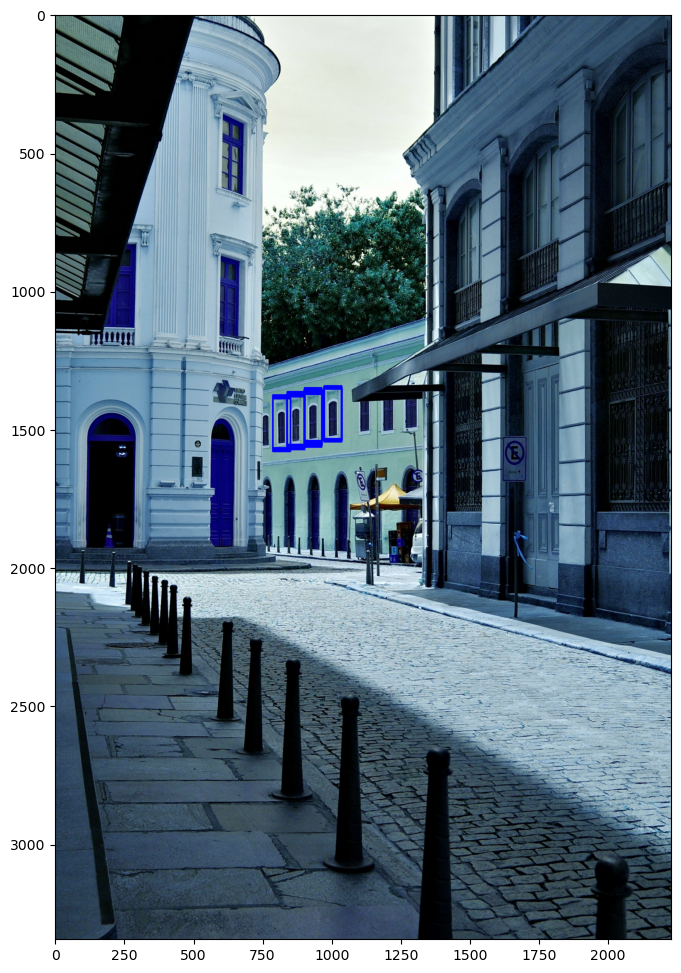

In [526]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

img_rgb = cv.imread("image.jpg")
img_gray = cv.cvtColor(img_rgb,cv.COLOR_BGR2GRAY)
template = cv.imread("template.jpg",cv.IMREAD_GRAYSCALE)
w, h = template.shape[::-1]

res = cv.matchTemplate(img_gray,template, cv.TM_CCOEFF_NORMED)
threshold = 0.8
loc = np.where( res >= threshold )
for pt in zip(*loc[::-1]):
    cv.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (0,0,255), 2)

plt.figure(figsize=(16,12))
plt.imshow(img_rgb)
plt.show()